In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# !pip install torchmetrics==1.4.0 scikit-learn lightning facenet_pytorch
# !pip install torch==2.4.0 torchmetrics scikit-learn lightning facenet_pytorch psutil GPUtil optuna
!pip install torch==2.6.0 torchmetrics scikit-learn lightning facenet_pytorch psutil GPUtil optuna

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 5.4 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of facenet-pytorch to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 108.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 95.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 60.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 41.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 20.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.0 MB/s eta 0:00:00
   ━━━━

In [4]:
# ! gdown --id 18gal2ndaPK_tIib40hGs8RG25CzeLJyp
# ! gdown --id 1r80lU8YHixB9JM07zmvs4_V4ytNVIIDF
! gdown --id 1wluaB2L0FSahIqSQQ6BOYfezGSjaS4_P #new from celeba-spoof

/usr/local/lib/python3.11/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1wluaB2L0FSahIqSQQ6BOYfezGSjaS4_P
From (redirected): https://drive.google.com/uc?id=1wluaB2L0FSahIqSQQ6BOYfezGSjaS4_P&confirm=t&uuid=4994aaff-77c3-467e-9345-7921e98eb08f
To: /content/celeba-spoof-cropped-data-latih.zip
100% 5.16G/5.16G [00:45<00:00, 113MB/s]


In [5]:
# !unzip celeba-spoof-sample.zip
# !unzip dataset-fitting.zip
!unzip celeba-spoof-cropped-data-latih.zip

Streaming output truncated to the last 5000 lines.
  inflating: celeba-spoof-cropped-data-latih/spoof/554082.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/554084.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/554085.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/554086.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/554087.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/554088.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/554090.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/554091.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/554092.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/554093.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/554094.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/554095.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/554097.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/554099.png  
  inflating: celeba-spoof-cropped-data-latih/spoof/55

In [6]:
import os
import cv2
import time
import psutil
import GPUtil
import math
import copy
import random
import gc
from glob import glob
from tqdm import tqdm
import numpy as np
import pandas as pd

import torch
import torchmetrics
from torchmetrics.classification import BinaryAUROC
# from torchmetrics.functional import auc
import torch.nn as nn
from torch.nn.functional import softmax
import torch.nn.functional as F
from collections import OrderedDict
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset, Subset
from torchvision.models import squeezenet1_1, shufflenet_v2_x2_0, mobilenet_v2, mobilenet_v3_small, mobilenet_v3_large, resnet50
from sklearn.model_selection import KFold

import optuna
from optuna.samplers import TPESampler
from optuna.pruners import HyperbandPruner

# import lightning.pytorch as pl
# from lightning.pytorch.loggers import CSVLogger
# from lightning.pytorch.callbacks.early_stopping import EarlyStopping

seed = 1
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
# pl.seed_everything(seed)

from PIL import Image
from facenet_pytorch import MTCNN

import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

In [7]:
device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
device

'cuda:0'

In [8]:
# Fungsi untuk mendapatkan semua file gambar dalam direktori secara rekursif
def list_image_files(directory, extensions=('jpg', 'jpeg', 'png', 'bmp', 'gif')):
    """
    Mendapatkan daftar semua file gambar dalam direktori secara rekursif.

    Args:
        directory (str): Path ke direktori.
        extensions (tuple): Ekstensi file gambar yang diizinkan.

    Returns:
        list: Daftar path file gambar.
    """
    image_files = []
    for ext in extensions:
        # Gunakan glob untuk mencari file dengan ekstensi tertentu secara rekursif
        image_files.extend(glob(os.path.join(directory, '**', f'*.{ext}'), recursive=True))
    return image_files

In [9]:
# Path ke direktori
# directory_path = "C:/Data/thesis/penelitian-citra/ipynb lmfr cutting model/dataset"
# directory_path = "/content/celeba-spoof-sample"
# directory_path = "/content/dataset-fitting"
directory_path = "/content/celeba-spoof-cropped-data-latih"

# Dapatkan daftar semua file gambar
image_files = list_image_files(directory_path)


In [ ]:
print(image_files)

['/content/celeba-spoof-cropped-data-latih/spoof/338474.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/064752.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/344136.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/434996.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/409359.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/098611.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/201876.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/028224.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/128203.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/021689.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/490908.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/238453.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/311258.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/305209.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/397518.jpg', '/content/celeba-spoof-cropped-data-latih/spoof/254444.jpg', '/content/celeba-spoof-

In [10]:
import re
Path = 'C:/Data/thesis/penelitian-citra/data/celeba-spoof-sample\\1\\live\\338474.jpg'
NewPath = re.sub(r'(\\)', '/', Path)
print(f"New path = {NewPath}")

New path = C:/Data/thesis/penelitian-citra/data/celeba-spoof-sample/1/live/338474.jpg


In [11]:
new_image_files = []
for i, path_file in enumerate(image_files):
    new_path = re.sub(r'(\\)', '/', path_file)
    new_image_files.append(new_path)

In [ ]:
print(new_image_files)

['/content/dataset-fitting/live/488553.jpg', '/content/dataset-fitting/live/160176.jpg', '/content/dataset-fitting/live/261613.jpg', '/content/dataset-fitting/live/395594.jpg', '/content/dataset-fitting/live/369519.jpg', '/content/dataset-fitting/live/088730.jpg', '/content/dataset-fitting/live/213007.jpg', '/content/dataset-fitting/live/263145.jpg', '/content/dataset-fitting/live/207706.jpg', '/content/dataset-fitting/live/442109.jpg', '/content/dataset-fitting/live/493255.jpg', '/content/dataset-fitting/live/399891.jpg', '/content/dataset-fitting/live/380273.jpg', '/content/dataset-fitting/live/347104.jpg', '/content/dataset-fitting/live/287826.jpg', '/content/dataset-fitting/live/211566.jpg', '/content/dataset-fitting/live/396118.jpg', '/content/dataset-fitting/live/109265.jpg', '/content/dataset-fitting/live/463979.jpg', '/content/dataset-fitting/live/449661.jpg', '/content/dataset-fitting/live/450187.jpg', '/content/dataset-fitting/live/248894.jpg', '/content/dataset-fitting/live/

In [12]:
def create_label(image_files):
    label_files = []
    spoof_types = []
    for i, file_path in enumerate(image_files):
        direktori = os.path.dirname(file_path)
        spoof = os.path.basename(direktori)
        # print(spoof)
        if (spoof=='live'):
            label = 1
        else:
            label = 0

        label_files.append(label)
        spoof_types.append(spoof)

    return label_files, spoof_types

In [13]:
labels, spoofs = create_label(image_files)

In [ ]:
print(labels)

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

In [14]:
dict_spoof = {
    'Filepath':image_files,
    'label':labels,
    'spoof_type': spoofs
}

In [15]:
df_spoof = pd.DataFrame.from_dict(dict_spoof)

In [16]:
df_spoof.head(2)

,Filepath,label,spoof_type
0,/content/celeba-spoof-cropped-data-latih/spoof...,0,spoof
1,/content/celeba-spoof-cropped-data-latih/spoof...,0,spoof


In [17]:
df_spoof['label'].value_counts()

,count
label,
0,359299
1,153983


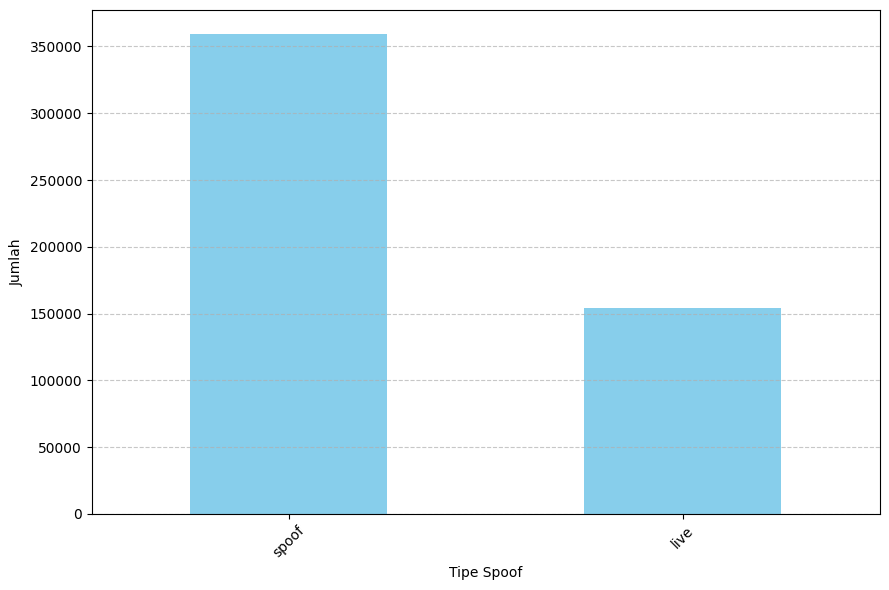

In [18]:
# Menghitung jumlah masing-masing spoof_type
spoof_type_counts = df_spoof['spoof_type'].value_counts()

plt.figure(figsize=(9, 6))
spoof_type_counts.plot(kind='bar', color='skyblue')
# plt.title('Jumlah Entri Berdasarkan Tipe Spoof')
plt.xlabel('Tipe Spoof')
plt.ylabel('Jumlah')
plt.xticks(rotation=45) # Rotasi untuk label yang panjang
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

**Downsampling**

In [19]:
    from sklearn.utils import resample

    df_majority = df_spoof[df_spoof.label == 0]
    df_minority = df_spoof[df_spoof.label == 1]

    # Downsample majority class
    df_majority_downsampled = resample(df_majority,
                                       replace=False,    # sample without replacement
                                       n_samples=len(df_minority), # match minority n
                                       random_state=123) # reproducible results

    # Combine minority class with downsampled majority class
    df_downsampled = pd.concat([df_majority_downsampled, df_minority])
    print(df_downsampled['label'].value_counts())

label
0    153983
1    153983
Name: count, dtype: int64


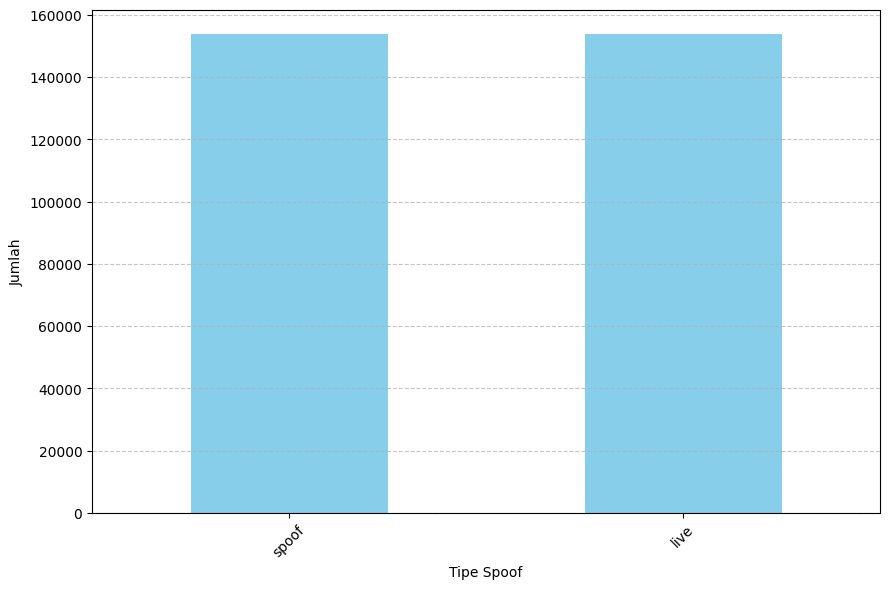

In [ ]:
# Menghitung jumlah masing-masing spoof_type
spoof_type_counts = df_downsampled['spoof_type'].value_counts()

plt.figure(figsize=(9, 6))
spoof_type_counts.plot(kind='bar', color='skyblue')
# plt.title('Jumlah Entri Berdasarkan Tipe Spoof')
plt.xlabel('Tipe Spoof')
plt.ylabel('Jumlah')
plt.xticks(rotation=45) # Rotasi untuk label yang panjang
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [20]:
sample_data = df_downsampled.sample(frac=0.065, replace=True, random_state=42)

In [21]:
sample_data['label'].value_counts()

,count
label,
0,10012
1,10006


In [22]:
    df_sample_majority = sample_data[sample_data.label == 0]
    df_sample_minority = sample_data[sample_data.label == 1]

    # Downsample majority class
    df_sample_majority_downsampled = resample(df_sample_majority,
                                       replace=False,    # sample without replacement
                                       n_samples=len(df_sample_minority), # match minority n
                                       random_state=123) # reproducible results

    # Combine minority class with downsampled majority class
    df_sample_downsampled = pd.concat([df_sample_majority_downsampled, df_sample_minority])
    print(df_sample_downsampled['label'].value_counts())

label
0    10006
1    10006
Name: count, dtype: int64


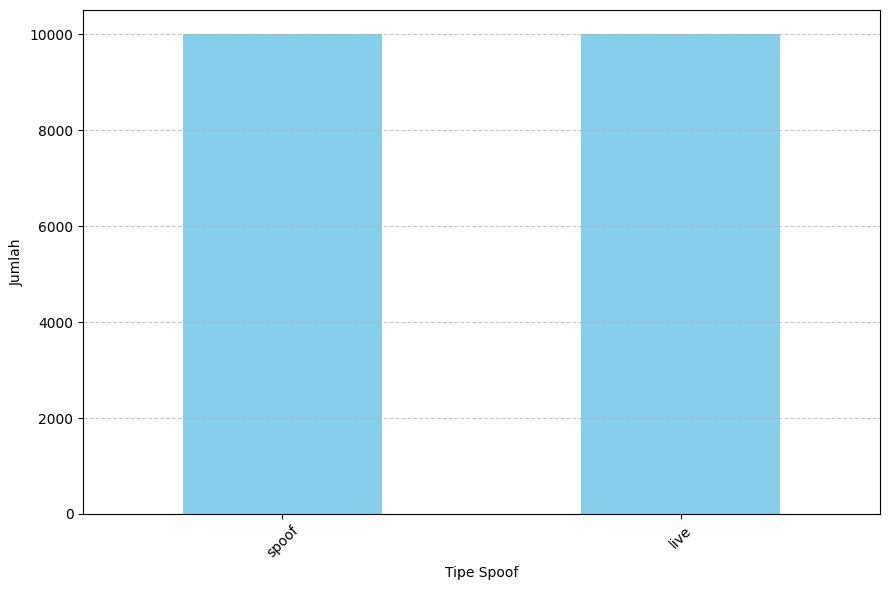

In [ ]:
# Menghitung jumlah masing-masing spoof_type
spoof_type_counts = df_sample_downsampled['spoof_type'].value_counts()

plt.figure(figsize=(9, 6))
spoof_type_counts.plot(kind='bar', color='skyblue')
# plt.title('Jumlah Entri Berdasarkan Tipe Spoof')
plt.xlabel('Tipe Spoof')
plt.ylabel('Jumlah')
plt.xticks(rotation=45) # Rotasi untuk label yang panjang
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

**DATAFRAME BALANCE TO K-FOLD**

**Enhancement Gambar Menggunakan CLAHE**

In [23]:
def enhance_with_clahe(image_path, show_execution_time = False):
    waktu_awal = time.time()
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Konversi ke RGB
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))  #Algoritma CLAHE
    l = clahe.apply(l)
    lab = cv2.merge((l, a, b))
    enhanced_image = cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)
    waktu_akhir = time.time()
    waktu_eksekusi = (waktu_akhir - waktu_awal) * 1000
    if show_execution_time:
        print(f"Waktu eksekusi algoritma CLAHE: {waktu_eksekusi:.2f} ms")
    return enhanced_image

**CLAHE ALGORITHM**

In [24]:
def percentageDarknessImage(filename=''):
    # Load image as greyscale
    im = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    if im is None:
        # print(f'ERROR: Unable to load {filename}')
        return False

    # Calculate mean brightness as percentage
    meanpercent = np.mean(im) * 100 / 255
    if meanpercent < 20:
        classification = 'Pitch-Black'
    elif meanpercent < 40:
        classification = 'Dark'
    elif meanpercent < 60:
        classification = 'Normal'
    elif meanpercent < 80:
        classification = 'Light'
    else:
        classification = 'Bright'

    # print(f'{filename}: {classification} ({meanpercent:.1f}%)')
    return meanpercent, classification

In [25]:
images_lowlight = []

def is_image_lowlight(row):
    image_path = row['Filepath']
    spoof_label = row['label']
    if spoof_label==1:
        percentage_lowlight, lowlight_class = percentageDarknessImage(image_path)
        if percentage_lowlight <= 30:
            images_lowlight.append(image_path)

In [26]:
from tqdm import tqdm

tqdm.pandas()

df_sample_downsampled.progress_apply(is_image_lowlight, axis=1)

100%|██████████| 20012/20012 [00:02<00:00, 7639.90it/s]


,0
454377,None
467267,None
51935,None
82138,None
87179,None
...,...
406575,None
437610,None
348230,None
428473,None


In [27]:
len(images_lowlight)

899

In [28]:
# sample_lowlight = sample_lowlight[:10]
sample_lowlight = [random.sample(images_lowlight, k=1)[0] for i in range(150)]
print(sample_lowlight[15::1])
print(len(sample_lowlight[:10:1]))

['/content/celeba-spoof-cropped-data-latih/live/061406.jpg', '/content/celeba-spoof-cropped-data-latih/live/381117.jpg', '/content/celeba-spoof-cropped-data-latih/live/310971.jpg', '/content/celeba-spoof-cropped-data-latih/live/438967.jpg', '/content/celeba-spoof-cropped-data-latih/live/072487.jpg', '/content/celeba-spoof-cropped-data-latih/live/144692.jpg', '/content/celeba-spoof-cropped-data-latih/live/422523.jpg', '/content/celeba-spoof-cropped-data-latih/live/551201.png', '/content/celeba-spoof-cropped-data-latih/live/395201.jpg', '/content/celeba-spoof-cropped-data-latih/live/046505.jpg', '/content/celeba-spoof-cropped-data-latih/live/032496.jpg', '/content/celeba-spoof-cropped-data-latih/live/206523.jpg', '/content/celeba-spoof-cropped-data-latih/live/457707.jpg', '/content/celeba-spoof-cropped-data-latih/live/262668.jpg', '/content/celeba-spoof-cropped-data-latih/live/079412.jpg', '/content/celeba-spoof-cropped-data-latih/live/490054.jpg', '/content/celeba-spoof-cropped-data-lat

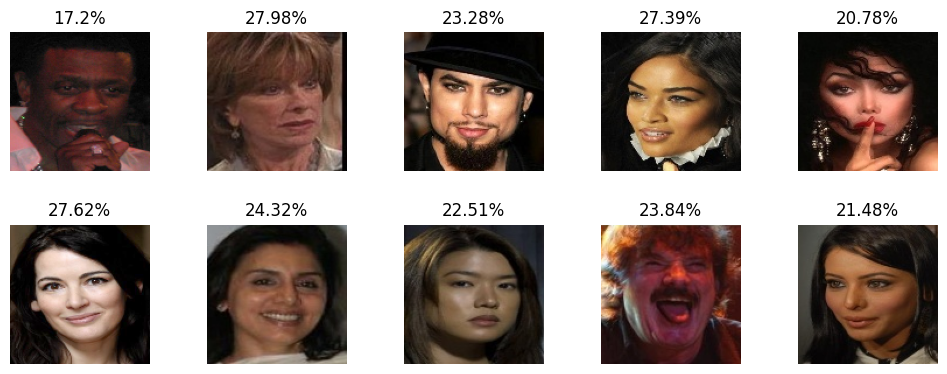

In [ ]:
# import str

fig, axes = plt.subplots(2, 5, figsize=(10, 4))
fig.tight_layout()

# Flatten the axes array for easy iteration
axes = axes.ravel()

# Display each image
for idx, image in enumerate(sample_lowlight[:10:1]):
    if idx>9:
        break
    img = cv2.imread(image)
    darkness, darkness_name = percentageDarknessImage(image)
    str_darkness = str(round(darkness, 2)) + '%'
    # Konversi dari BGR ke RGB
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    axes[idx].imshow(img_rgb)
    axes[idx].set_title(str_darkness)
    axes[idx].axis('off')  # Turn off axis labels

plt.show()

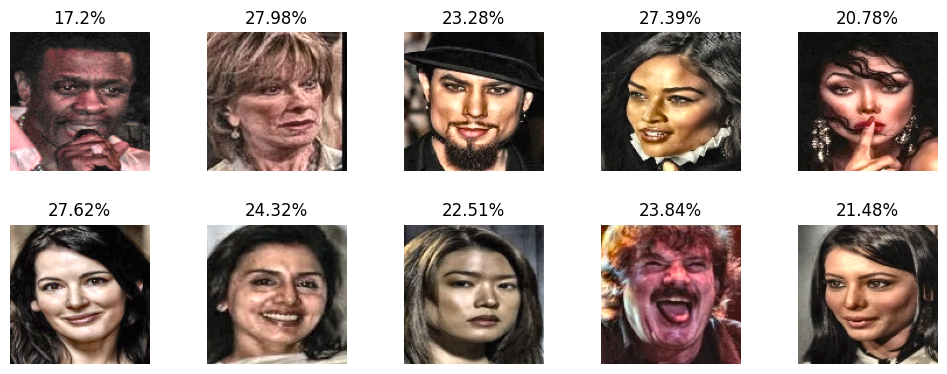

In [ ]:
# import str

fig, axes = plt.subplots(2, 5, figsize=(10, 4))
fig.tight_layout()

# Flatten the axes array for easy iteration
axes = axes.ravel()

# Display each image
for idx, image in enumerate(sample_lowlight[:10:1]):
    if idx>9:
        break
    darkness, darkness_name = percentageDarknessImage(image)
    str_darkness = str(round(darkness, 2)) + '%'
    # Konversi dari BGR ke RGB
    img_rgb = enhance_with_clahe(image)
    axes[idx].imshow(img_rgb)
    axes[idx].set_title(str_darkness)
    axes[idx].axis('off')  # Turn off axis labels

plt.show()

**LMFRNet**

In [29]:
class MMConv(nn.Module):
    def __init__(self, num_input_features, growth_rate, bottleneck_width):
        super(MMConv, self).__init__()
        inter_channel = int(growth_rate  * bottleneck_width/2)
        growth_branch = int(growth_rate / 4)
        self.branch11 = ConvNormRelu(num_input_features, inter_channel, kernel_size=1)
        self.branch33a = ConvNormRelu(inter_channel, inter_channel, kernel_size=3,padding=1)
        self.branch33b = ConvNormRelu(inter_channel, growth_branch, kernel_size=3,padding=1)
        self.branch33c = ConvNormRelu(growth_branch, growth_branch, kernel_size=3,padding=1)

    def forward(self, x):
        y0 = self.branch11(x)
        y1 = self.branch33a(y0)
        y2 = self.branch33b(y1)
        y3 = self.branch33c(y2)
        z=torch.cat([x, y1, y2,y3], 1)
        return z

class MMBlock(nn.Sequential):
    def __init__(self, num_layers, num_input_features, bn_size, growth_rate):
        super(MMBlock, self).__init__()
        for i in range(num_layers):
            layer = MMConv(num_input_features + i * growth_rate, growth_rate, bn_size)
            self.add_module('mmLayer%d' % (i + 1), layer)

class StemBlock(nn.Module):
    def __init__(self, num_input_channels, num_init_features):
        super(StemBlock, self).__init__()

        self.stemConv = nn.Sequential(
            nn.Conv2d(in_channels=num_input_channels, out_channels=num_init_features, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(num_init_features),
            nn.ReLU()
        )

    def forward(self, x):
        out2 = self.stemConv(x)
        return out2

class ConvNormRelu(nn.Module):

    def __init__(self, in_channels, out_channels, **kwargs):
        super(ConvNormRelu, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, bias=False, **kwargs)
        self.norm = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        x = self.conv(x)
        x = self.norm(x)
        x = F.relu(x, inplace=True)
        return x

class LMFRNet(nn.Module):
    def __init__(self, growth_rate=[24, 24, 24, 24], block_config=[3, 4, 8, 3],
                 num_init_features=32, bottleneck_width=[1, 1, 1, 1],  num_classes=10):

        super(LMFRNet, self).__init__()


        self.features = nn.Sequential(OrderedDict([
            ('stemBlock', StemBlock(3, num_init_features)),
        ]))
        growth_rates = growth_rate
        bottleneck_widths = bottleneck_width

        num_features = num_init_features
        for i, num_layers in enumerate(block_config):
            block = MMBlock(num_layers=num_layers, num_input_features=num_features,
                                bn_size=bottleneck_widths[i], growth_rate=growth_rates[i])
            self.features.add_module('MMCBlock%d' % (i + 1), block)
            num_features = num_features + num_layers * growth_rates[i]

            self.features.add_module('tran_ConvNormRelu%d' % (i + 1), ConvNormRelu(
                num_features, num_features, kernel_size=1, stride=1, padding=0))

            if i != len(block_config) - 1:
                self.features.add_module('tran_pool%d' % (i + 1), nn.AvgPool2d(kernel_size=2, stride=2))
                num_features = num_features

        self.classifier = nn.Linear(num_features, num_classes)
        self.add_module('fc', self.classifier)
        self._initialize_weights()

    def forward(self, x):
        features = self.features(x)
        out = F.avg_pool2d(features, kernel_size=(features.size(2), features.size(3))).view(features.size(0), -1)
        out = self.classifier(out)
        return out

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
                if m.bias is not None:
                    m.bias.data.zero_()
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()
            elif isinstance(m, nn.Linear):
                n = m.weight.size(1)
                m.weight.data.normal_(0, 0.01)
                m.bias.data.zero_()


**Build Base Models**

In [30]:
class_names = pd.unique(df_sample_downsampled['label'])
num_classes = len(class_names)

class_names

array([0, 1])

In [31]:
model_lmfrnet = LMFRNet(num_classes=num_classes)
model_shufflenet = shufflenet_v2_x2_0(pretrained=True)
model_mobilenet_sm = mobilenet_v3_small(pretrained=True)
model_restnet = resnet50(pretrained=True)

Downloading: "https://download.pytorch.org/models/shufflenetv2_x2_0-8be3c8ee.pth" to /root/.cache/torch/hub/checkpoints/shufflenetv2_x2_0-8be3c8ee.pth
100%|██████████| 28.4M/28.4M [00:00<00:00, 169MB/s]
Downloading: "https://download.pytorch.org/models/mobilenet_v3_small-047dcff4.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_small-047dcff4.pth
100%|██████████| 9.83M/9.83M [00:00<00:00, 134MB/s]
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 220MB/s]


In [32]:
model_lmfrnet_default = LMFRNet(num_classes=num_classes)
model_shufflenet_default = shufflenet_v2_x2_0(pretrained=True)
model_mobilenet_sm_default = mobilenet_v3_small(pretrained=True)
model_restnet_default = resnet50(pretrained=True)


**LMFRNET  PRE-TRAINED**

In [33]:
model_lmfrnet


LMFRNet(
  (features): Sequential(
    (stemBlock): StemBlock(
      (stemConv): Sequential(
        (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU()
      )
    )
    (MMCBlock1): MMBlock(
      (mmLayer1): MMConv(
        (branch11): ConvNormRelu(
          (conv): Conv2d(32, 12, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (norm): BatchNorm2d(12, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (branch33a): ConvNormRelu(
          (conv): Conv2d(12, 12, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (norm): BatchNorm2d(12, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (branch33b): ConvNormRelu(
          (conv): Conv2d(12, 6, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (norm): BatchNorm2d(6, eps=1e-05, momentum=0.1, a

**SHUFFLENET  PRE-TRAINED**

In [35]:
model_shufflenet

ShuffleNetV2(
  (conv1): Sequential(
    (0): Conv2d(3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    (0): InvertedResidual(
      (branch1): Sequential(
        (0): Conv2d(24, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=24, bias=False)
        (1): BatchNorm2d(24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): Conv2d(24, 122, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (3): BatchNorm2d(122, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (4): ReLU(inplace=True)
      )
      (branch2): Sequential(
        (0): Conv2d(24, 122, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(122, eps=1e-05, momentum=0.1, affine=True, track_runn

**MOBILENET PRE-TRAINED**

In [36]:
model_mobilenet_sm

MobileNetV3(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
      (2): Hardswish()
    )
    (1): InvertedResidual(
      (block): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=16, bias=False)
          (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
        )
        (1): SqueezeExcitation(
          (avgpool): AdaptiveAvgPool2d(output_size=1)
          (fc1): Conv2d(16, 8, kernel_size=(1, 1), stride=(1, 1))
          (fc2): Conv2d(8, 16, kernel_size=(1, 1), stride=(1, 1))
          (activation): ReLU()
          (scale_activation): Hardsigmoid()
        )
        (2): Conv2dNormActivation(
          (0): Conv2d(16, 16, kernel_size=(1, 1), 

**RESTNET PRE-TRAINED**

In [37]:
model_restnet

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

**LMFRNET MODEL FINE-TUNNING**

In [38]:
lmfrnet_features = model_lmfrnet.classifier.in_features

# model_lmfrnet.fc = nn.Sequential(
model_lmfrnet.classifier = nn.Sequential(
    nn.Linear(lmfrnet_features, 256),  # Additional linear layer with 256 output features
    nn.ReLU(inplace=True),         # Activation function (you can choose other activation functions too)
    nn.Dropout(0.5),               # Dropout layer with 50% probability
    nn.Linear(256, num_classes)    # Final prediction fc layer
)


In [39]:
lmfrnet_features = model_lmfrnet_default.classifier.in_features

# model_lmfrnet.fc = nn.Sequential(
model_lmfrnet_default.classifier = nn.Sequential(
    nn.Linear(lmfrnet_features, 256),  # Additional linear layer with 256 output features
    nn.ReLU(inplace=True),         # Activation function (you can choose other activation functions too)
    nn.Dropout(0.5),               # Dropout layer with 50% probability
    nn.Linear(256, num_classes)    # Final prediction fc layer
)

In [40]:
# model_lmfrnet

**SHUFFLENET MODEL FINE-TUNNING**

In [41]:
shufflenet_features = model_shufflenet.fc.in_features
shufflenet_features

2048

In [42]:
shufflenet_features = model_shufflenet.fc.in_features
model_shufflenet.fc = nn.Sequential(
    nn.Linear(shufflenet_features, 256),  # Additional linear layer with 256 output features
    nn.ReLU(inplace=True),         # Activation function (you can choose other activation functions too)
    nn.Dropout(0.5),               # Dropout layer with 50% probability
    nn.Linear(256, num_classes)    # Final prediction fc layer
)

# model_shufflenet

In [43]:
shufflenet_features = model_shufflenet_default.fc.in_features
model_shufflenet_default.fc = nn.Sequential(
    nn.Linear(shufflenet_features, 256),  # Additional linear layer with 256 output features
    nn.ReLU(inplace=True),         # Activation function (you can choose other activation functions too)
    nn.Dropout(0.5),               # Dropout layer with 50% probability
    nn.Linear(256, num_classes)    # Final prediction fc layer
)

# model_shufflenet

**MOBILENET MODEL FINE-TUNNING**

In [44]:
mobilenet_features = model_mobilenet_sm.classifier[0].in_features
mobilenet_features

576

In [45]:
mobilenet_features = model_mobilenet_sm.classifier[0].in_features
model_mobilenet_sm.classifier = nn.Sequential(
    nn.Linear(mobilenet_features, 256),  # Additional linear layer with 256 output features
    nn.ReLU(inplace=True),         # Activation function (you can choose other activation functions too)
    nn.Dropout(0.5),               # Dropout layer with 50% probability
    nn.Linear(256, num_classes)    # Final prediction fc layer
)
# model_mobilenet_sm


In [46]:
mobilenet_features = model_mobilenet_sm_default.classifier[0].in_features
model_mobilenet_sm_default.classifier = nn.Sequential(
    nn.Linear(mobilenet_features, 256),  # Additional linear layer with 256 output features
    nn.ReLU(inplace=True),         # Activation function (you can choose other activation functions too)
    nn.Dropout(0.5),               # Dropout layer with 50% probability
    nn.Linear(256, num_classes)    # Final prediction fc layer
)
# model_mobilenet_sm


**RESTNET MODEL FINE TUNNING**

In [47]:
restnet_features = model_restnet.fc.in_features
model_restnet.fc = nn.Sequential(
    nn.Linear(shufflenet_features, 256),  # Additional linear layer with 256 output features
    nn.ReLU(inplace=True),         # Activation function (you can choose other activation functions too)
    nn.Dropout(0.5),               # Dropout layer with 50% probability
    nn.Linear(256, num_classes)    # Final prediction fc layer
)

# model_restnet

In [48]:
restnet_features = model_restnet_default.fc.in_features
model_restnet_default.fc = nn.Sequential(
    nn.Linear(shufflenet_features, 256),  # Additional linear layer with 256 output features
    nn.ReLU(inplace=True),         # Activation function (you can choose other activation functions too)
    nn.Dropout(0.5),               # Dropout layer with 50% probability
    nn.Linear(256, num_classes)    # Final prediction fc layer
)

# model_restnet_default

**Training and Evaluation**

In [49]:
class MobileNetV3Small(nn.Module):
    """Modified MobileNetV3 Small for face spoofing detection"""
    def __init__(self, pretrained=True, dropout_rate=0.2, num_classes=2):
        super(MobileNetV3Small, self).__init__()
        self.base_model = mobilenet_v3_small(pretrained=pretrained)

        # Modify the classifier head
        in_features = self.base_model.classifier[-1].in_features
        self.base_model.classifier = nn.Sequential(
            nn.Linear(in_features, 512),
            nn.Hardswish(),
            nn.Dropout(p=dropout_rate),
            nn.Linear(512, num_classes)
        )

    def forward(self, x):
        return self.base_model(x)


In [50]:
# Resource monitoring class
class ResourceMonitor:
    def __init__(self):
        # self.process = psutil.Process(os.getpid())
        # self.initial_cpu = self.process.cpu_percent()
        # self.initial_mem = self.process.memory_info().rss / (1024 * 1024)  # MB
        # gpus = GPUtil.getGPUs()
        # self.initial_gpu_mem = gpus[0].memoryUsed if gpus else 0
        self.start_time = time.time()

    def get_usage(self):
        ram_total = psutil.virtual_memory().total / (1024**3) # in GigaByte
        ram_usage = psutil.virtual_memory().used / (1024**3) # in GigaByte
        ram_available = psutil.virtual_memory().available / (1024**3) # in GigaByte
        gpu_total = 0
        gpu_alocated_memory =0
        gpu_memory_cached = 0


        if torch.cuda.is_available():
            gpu_total = torch.cuda.get_device_properties(0).total_memory / (1024**3) # in GigaByte
            gpu_alocated_memory = torch.cuda.memory_allocated(0) / (1024**3) # in GigaByte
            gpu_memory_cached = torch.cuda.memory_cached(0) / (1024**3) # in GigaByte

        current_cpu = psutil.cpu_percent(interval=1) # in percentage

        # current_mem = self.process.memory_info().rss / (1024 * 1024)
        # gpus = GPUtil.getGPUs()
        # current_gpu_mem = gpus[0].memoryUsed if gpus else 0
        elapsed_time = time.time() - self.start_time

        # return {
        #     'time': elapsed_time,
        #     'cpu': current_cpu - self.initial_cpu,
        #     'memory': current_mem - self.initial_mem,
        #     'gpu_memory': current_gpu_mem - self.initial_gpu_mem
        # }

        return {
            'time': elapsed_time,
            'cpu': current_cpu,
            'memory': current_mem - self.initial_mem,
            'gpu_memory': current_gpu_mem - self.initial_gpu_mem
        }


In [51]:
class CelebADataset(Dataset):
    def __init__(self, df, transforms=None):
        self.df = df
        self.transforms = transforms

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        img_path = self.df.iloc[idx]['Filepath']

        darkness, darkness_name = percentageDarknessImage(img_path)
        if darkness < 30:
            image_rgb = enhance_with_clahe(img_path)
        else:
            image = cv2.imread(img_path)
            image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Konversi ke RGB

        img = Image.fromarray(image_rgb)  # Konversi ke format PIL

        label = self.df.iloc[idx]['label']

        if self.transforms is not None:
            # image = self.transforms(img)
            img = self.transforms(img)

        return img, label
        # return image, label

In [69]:
from collections import Counter

class Trainer:
    def __init__(self, model, criterion, optimizer, device='cpu', epochs=5, num_classes=2):
        self.model = model
        self.criterion = criterion
        self.optimizer = optimizer
        self.device = device
        self.epochs = epochs
        self.model.to(self.device)

        # Metrics
        self.metrics = torchmetrics.MetricCollection({
            'accuracy': torchmetrics.Accuracy(task="binary", num_classes=num_classes),
            'precision': torchmetrics.Precision(task="binary", num_classes=num_classes, average='macro'),
            'f1score': torchmetrics.F1Score(task="binary", num_classes=num_classes, average='macro'),
            'specificity': torchmetrics.Specificity(task="binary", num_classes=num_classes, average='macro'),
            'recall': torchmetrics.Recall(task="binary", num_classes=num_classes, average='macro')
        }).to(self.device)

    def _get_gpu_usage(self):
        """Get GPU usage percentage if available"""
        if torch.cuda.is_available():
            return torch.cuda.utilization()
        return None

    def _get_gpu_memory(self):
        """Get GPU memory usage if available"""
        if torch.cuda.is_available():
            return torch.cuda.memory_allocated() / torch.cuda.max_memory_allocated() * 100
        return None

    def train(self, train_loader):
        val_loss = 0.0
        all_preds = []
        all_targets =[]

        class_distribution = {}

        # Count class occurrences
        class_counts = Counter()
        for _, labels in train_loader:
            class_counts.update(labels.tolist()) # Convert labels to a list for Counter

        print("Distribusi data class dataloader train:")
        for class_id, count in class_counts.items():
            class_distribution[class_id] = count
            if class_id == 1:
                spoof_type = 'Live'
            else:
                spoof_type = 'Spoof'

            print(f"{spoof_type}: {count} images")

        self.model.train()
        for epoch in range(self.epochs):
            running_loss = 0.0
            for inputs, targets in train_loader:

                inputs, targets = inputs.to(self.device), targets.to(self.device)
                self.optimizer.zero_grad()
                outputs = self.model(inputs)
                preds = torch.argmax(outputs, dim=1)

                loss = self.criterion(outputs, targets)
                val_loss += loss
                loss.backward()
                self.optimizer.step()
                running_loss += loss.item()

                all_preds.append(preds)
                all_targets.append(targets)

            print(f"Epoch [{epoch + 1}/{self.epochs}], Loss: {running_loss / len(train_loader):.4f}")

        all_preds = torch.cat(all_preds)
        all_targets = torch.cat(all_targets)

        # Compute metrics
        val_loss /= len(train_loader)
        metrics = self.metrics(all_preds, all_targets)

        print(class_distribution)
        print(f"Loss: {val_loss:.4f}, Akurasi: {metrics['accuracy'].item()}")
        # print(f"Loss: {val_loss:.4f}, Akurasi: {metrics['accuracy'].item()}, Total Live: {class_distribution[1]}, Total Spoof: {class_distribution[0]}")
        return val_loss, metrics, class_distribution


    def evaluate(self, val_loader):
        self.model.eval()
        val_loss = 0.0
        all_preds = []
        all_targets = []
        all_cpu_usages = []
        all_memory_usages = []
        all_gpu_usages = []
        all_gpu_memory_usages = []

        # calculatinge each image
        start_time = time.time()
        # # Get resource usage before inference
        # cpu_before = psutil.cpu_percent()
        # memory_before = psutil.virtual_memory().percent
        # gpu_before = self._get_gpu_usage()
        # gpu_mem_before = self._get_gpu_memory()

        class_distribution = {}

        # Count class occurrences
        class_counts = Counter()
        for _, labels in val_loader:
            class_counts.update(labels.tolist()) # Convert labels to a list for Counter

        print("Distribusi data class dataloader evaluate:")
        for class_id, count in class_counts.items():
            class_distribution[class_id] = count
            if class_id == 1:
                spoof_type = 'Live'
            else:
                spoof_type = 'Spoof'

            print(f"{spoof_type}: {count} images")


        with torch.no_grad():
            for inputs, targets in val_loader:
                class_distribution = dict(Counter(targets))

                inputs, targets = inputs.to(self.device), targets.to(self.device)
                outputs = self.model(inputs)
                val_loss += self.criterion(outputs, targets).item()
                preds = torch.argmax(outputs, dim=1)

                # Get resource usage after inference
                # cpu_usage = psutil.cpu_percent()
                # memory_usage = psutil.virtual_memory().percent
                # gpu_usage = self._get_gpu_usage()
                # gpu_mem_usage = self._get_gpu_memory()
                cpu_usage = psutil.cpu_percent(interval=1) # in percentage
                memory_usage = psutil.virtual_memory().used / (1024**3) # in GigaByte
                gpu_usage = torch.cuda.memory_cached(0) / (1024**3) # in GigaByte
                gpu_mem_usage = torch.cuda.memory_allocated(0) / (1024**3) # in GigaByte

                all_preds.append(preds)
                all_targets.append(targets)

                all_cpu_usages.append(float(cpu_usage))
                all_memory_usages.append(float(memory_usage))
                all_gpu_usages.append(float(gpu_usage) if gpu_usage is not None else 0)
                all_gpu_memory_usages.append(float(gpu_mem_usage) if gpu_mem_usage is not None else 0)


        inference_time = time.time() - start_time

        cpu_usage = np.mean(all_cpu_usages)
        memory_usage = np.mean(all_memory_usages)
        gpu_usage = np.mean(all_gpu_usages)
        gpu_memory_usage = np.mean(all_gpu_memory_usages)

        all_preds = torch.cat(all_preds)
        all_targets = torch.cat(all_targets)

        # Compute metrics
        val_loss /= len(val_loader)
        metrics = self.metrics(all_preds, all_targets)
        b_auroc = BinaryAUROC(thresholds=None)
        tensor_auroc = b_auroc(all_preds, all_targets)
        auroc = tensor_auroc.item()
        # tensor_auc = auc(all_preds, all_targets)
        # auc = tensor_auc.item()

        # Specificity calculation
        tn = ((all_preds == 0) & (all_targets == 0)).sum().item()
        fp = ((all_preds == 0) & (all_targets != 0)).sum().item()
        specificity = tn / (tn + fp + 1e-10)  # Avoid division by zero

        # end_time = time.time()
        # time_elapsed = end_time - start_time

        print(f"Loss: {val_loss:.4f}, Akurasi: {metrics['accuracy'].item()}")
        # print(f"Loss: {val_loss:.4f}, Akurasi: {metrics['accuracy'].item()}, Total Live: {live}, Total Spoof: {spoof}")

        return {
            'loss': val_loss,
            'accuracy': metrics['accuracy'].item(),
            'precision': metrics['precision'].item(),
            'recall': metrics['recall'].item(),
            'f1score': metrics['f1score'].item(),
            'specificity': specificity,
            'auroc': auroc,
            # 'auc': auc,
            'inference_time': inference_time,
            'cpu_usage': float(cpu_usage),
            'memory_usage': float(memory_usage),
            'gpu_usage': float(gpu_usage),
            'gpu_memory_usage': float(gpu_memory_usage),
            'eval_class_distribution': class_distribution,
        }

In [70]:
def objective(trial, dataset, model, criterion, n_splits=5):
    gc.collect()
    torch.cuda.empty_cache()

    fold_results = {
        'loss': [],
        'accuracy': [],
        'precision': [],
        'recall': [],
        'f1score': [],
        'specificity': [],
        'auroc': [],
        'auc': [],
        'inference_time': [],
        'cpu_usage': [],
        'memory_usage': [],
        'gpu_usage': [],
        'gpu_memory_usage': [],
        'train_accuracy': [],
        'train_class_distribution': [],
        'eval_class_distribution': [],
    }

    # Suggest hyperparameters
    lr = trial.suggest_float('lr', 1e-3, 1e-1, log=True)
    batch_size = trial.suggest_categorical('batch_size', [32, 64, 128])
    epochs = trial.suggest_int('epochs', 5, 10)
    optimizer_name = trial.suggest_categorical('optimizer', ['adam', 'sgd', 'rmsprop'])
    # dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)
    # weight_decay = trial.suggest_float('weight_decay', 1e-6, 1e-3, log=True)

    kf = KFold(n_splits=n_splits, shuffle=True)

    best_f1_score = 0.0
    for fold, (train_idx, val_idx) in enumerate(kf.split(dataset)):

        start_time = time.time()

        print(f"Fold {fold + 1}/{n_splits}")
        train_subsampler = Subset(dataset, train_idx)
        val_subsampler = Subset(dataset, val_idx)

        train_loader = DataLoader(train_subsampler,
                                  batch_size=batch_size,
                                  shuffle=True)  # Faster data transfer to GPU
        val_loader = DataLoader(val_subsampler,
                                batch_size=batch_size,
                                shuffle=False)  # Faster data transfer to GPU

        # jml_data_train = len(train_loader)
        # print('Total data train: {jml_data_train}')

        # return True
        # Initialize model and optimizer
        # model = model_name
        # optimizer = optim.Adam(model.parameters(), lr=0.001)

        if optimizer_name == 'adam':
            optimizer = optim.Adam(model.parameters(), lr=lr)
        elif optimizer_name == 'sgd':
            optimizer = optim.SGD(model.parameters(), lr=lr)
        else:
            optimizer = optim.RMSprop(model.parameters(), lr=lr)

        trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, device=device, epochs=epochs)

        # Train the model
        train_loss, train_metrics, class_distribution = trainer.train(train_loader=train_loader)

        # Evaluate the model
        eval_metrics = trainer.evaluate(val_loader=val_loader)

        end_time = time.time()

        elapsed_time = end_time - start_time

        print(eval_metrics)

        for key in list(eval_metrics.keys()):
        # for key in fold_results:
            if key in fold_results:
                fold_results[key].append(eval_metrics[key])

        fold_results['train_accuracy'].append(train_metrics['accuracy'])
        fold_results['train_class_distribution'].append(class_distribution)
        # fold_results['time_elapsed'].append(elapsed_time)

        print(
            f"Fold {fold + 1} - Loss: {eval_metrics['loss']:.4f}, Accuracy: {eval_metrics['accuracy']:.4f}, "
            f"Precision: {eval_metrics['precision']:.4f}, Recall: {eval_metrics['recall']:.4f}, "
            f"Specificity: {eval_metrics['specificity']:.4f}, F1-Score: {eval_metrics['f1score']:.4f}, "
            f"AUROC: {eval_metrics['auroc']:.4f}, Inference Time: {eval_metrics['inference_time']:.4f}, "
            f"CPU Usage: {eval_metrics['cpu_usage']:.4f}, Memory Usage: {eval_metrics['memory_usage']:.4f}, "
            f"GPU Usage: {eval_metrics['gpu_usage']:.4f}, GPU Memory Usage: {eval_metrics['gpu_memory_usage']:.4f} "
        )

        if eval_metrics['f1score'] > best_f1_score:
            best_f1_score = eval_metrics['f1score']
            best_model = model.state_dict()

        gc.collect()
        torch.cuda.empty_cache()

    name_of_model = model.__class__.__name__

    target_model_to_saved = '/content/drive/MyDrive/penelitian/hasil-penelitian/best-model/best_model_' + name_of_model + '.pth'
    torch.save(best_model, target_model_to_saved)

    avg_resources = {
        'loss': np.mean(fold_results['loss']),
        'accuracy': np.mean(fold_results['accuracy']),
        'precision': np.mean(fold_results['precision']),
        'recall': np.mean(fold_results['recall']),
        'specificity': np.mean(fold_results['specificity']),
        'f1score': np.mean(fold_results['f1score']),
        'auroc': np.mean(fold_results['auroc']),
        'inference_time': np.mean(fold_results['inference_time']),
        'cpu_usage': np.mean(fold_results['cpu_usage']),
        'memory_usage': np.mean(fold_results['memory_usage']),
        'gpu_usage': np.mean(fold_results['gpu_usage']),
        'gpu_memory_usage': np.mean(fold_results['gpu_memory_usage']),
        'train_accuracy': np.mean(fold_results['accuracy']),
    }

    # avg_resources = {
    #     'loss': np.mean([r['loss'] for r in fold_results['loss']]),
    #     'accuracy': np.mean([r['accuracy'] for r in fold_results['accuracy']]),
    #     'precision': np.mean([r['precision'] for r in fold_results['precision']]),
    #     'recall': np.mean([r['recall'] for r in fold_results['recall']]),
    #     'specificity': np.mean([r['specificity'] for r in fold_results['specificity']]),
    #     'auroc': np.mean([r['auroc'] for r in fold_results['auroc']]),
    #     # 'auc': np.mean([r['auc'] for r in fold_results['auc']]),
    #     'inference_time': np.mean([r['inference_time'] for r in fold_results['inference_time']]),
    #     'cpu_usage': np.mean([r['cpu_usage'] for r in fold_results['cpu_usage']]),
    #     'memory_usage': np.mean([r['memory_usage'] for r in fold_results['memory_usage']]),
    #     'gpu_usage': np.mean([r['gpu_usage'] for r in fold_results['gpu_usage']]),
    #     'gpu_memory_usage': np.mean([r['gpu_memory_usage'] for r in fold_results['gpu_memory_usage']]),
    # }

    # Store resource usage in trial user attributes
    trial.set_user_attr('avg_loss', avg_resources['loss'])
    trial.set_user_attr('avg_accuracy', avg_resources['accuracy'])
    trial.set_user_attr('avg_precision', avg_resources['precision'])
    trial.set_user_attr('avg_specificity', avg_resources['specificity'])
    trial.set_user_attr('avg_f1score', avg_resources['f1score'])
    trial.set_user_attr('avg_auroc', avg_resources['auroc'])
    # trial.set_user_attr('avg_auc', avg_resources['auc'])
    trial.set_user_attr('avg_inference_time', avg_resources['inference_time'])
    trial.set_user_attr('avg_cpu_usage', avg_resources['cpu_usage'])
    trial.set_user_attr('avg_memory_usage', avg_resources['memory_usage'])
    trial.set_user_attr('avg_gpu_usage', avg_resources['gpu_usage'])
    trial.set_user_attr('avg_gpu_memory_usage', avg_resources['gpu_memory_usage'])
    trial.set_user_attr('eval_results', fold_results)
    trial.set_user_attr('target_saved_model', target_model_to_saved)

    # loss = np.mean(fold_results['loss'])
    # accuracy = np.mean(fold_results['accuracy'])
    # precision = np.mean(fold_results['precision'])
    # recall = np.mean(fold_results['recall'])
    # specificity = np.mean(fold_results['specificity'])
    auroc = np.mean(fold_results['auroc'])
    # auc = np.mean(fold_results['auc'])
    # inference_time = np.mean(fold_results['inference_time'])
    # cpu_usage = np.mean(fold_results['cpu_usage'])
    # memory_usage = np.mean(fold_results['memory_usage'])
    # gpu_usage = np.mean(fold_results['gpu_usage'])
    # gpu_memory_usage = np.mean(fold_results['gpu_memory_usage'])

    return auroc

In [71]:
def train_eval_model_optuna(model, dataset):
    name_of_model = model.__class__.__name__
    results = [];

    criterion = nn.CrossEntropyLoss()

    sampler = TPESampler(seed=42)  # Tree-structured Parzen Estimator
    pruner = HyperbandPruner()  # Prunes unpromising trials

    study = optuna.create_study(
        direction='maximize',
        sampler=sampler,
        pruner=pruner
    )

    # Run optimization
    study.optimize(
        # lambda trial: objective(trial, dataset, model, criterion),  # Using 5-fold for faster optimization
        lambda trial: objective(trial, dataset=dataset, model=model, criterion=criterion, n_splits=5),  # Using 5-fold for faster optimization
        n_trials=5,
        n_jobs=1  # Set to higher number if you want parallel trials (requires careful resource management)
    )

    # Print best trial
    print("\n=======================================")
    print("\nEvaluation Results of Model: " + name_of_model)
    print("\n=======================================")
    print("\nBest trial:")
    trial = study.best_trial
    print(f"Value (AUC): {trial.value:.4f}")
    print("Params: ")
    for key, value in trial.params.items():
        print(f"    {key}: {value}")

    print("\nAverage Resource Usage:")
    print(f"Inference Time: {trial.user_attrs['avg_inference_time']:.2f} seconds per fold")
    print(f"CPU Usage: {trial.user_attrs['avg_cpu_usage']:.2f}%")
    print(f"Memory Usage: {trial.user_attrs['avg_memory_usage']:.2f} MB")
    print(f"GPU Memory Usage: {trial.user_attrs['avg_gpu_memory_usage']:.2f} MB")

    best_batch_size = trial.params['batch_size']
    print(f"Best Batch Size: {best_batch_size}")

    # Train final model with best parameters on full dataset
    # print("\nTraining final model with best parameters...")

    optuna.visualization.plot_optimization_history(study).show()
    optuna.visualization.plot_param_importances(study).show()

    results = {'model_name': name_of_model, 'params': trial.params, 'eval': trial.user_attrs}

    return results

In [72]:
import json
eval_results = []

transform = transforms.Compose([
        # transforms.Resize(224),
        transforms.ToTensor(),
        transforms.Normalize(
            mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
        )
    ])

spoof_dataset = CelebADataset(df_sample_downsampled, transform)
# for fold, (train_ids, val_ids) in enumerate(kfold.split(df_sample)):
# model_name = [model_shufflenet, model_mobilenet_sm, model_lmfrnet]
model_name = [model_shufflenet_default, model_mobilenet_sm_default, model_restnet_default, model_lmfrnet_default]
# model_name = [model_lmfrnet]
for model in model_name:
    name_of_model = model.__class__.__name__

    print('*'*75)
    print(f'Training and evaluation model with optuna: {name_of_model}\n')
    print('*'*75)
    train_eval_results = train_eval_model_optuna(model, spoof_dataset)
    eval_results.append(train_eval_results)



[I 2025-07-04 04:10:37,930] A new study created in memory with name: no-name-234d7c35-8122-4d21-8c51-7964686b9e7b


***************************************************************************
Training and evaluation model with optuna: ShuffleNetV2

***************************************************************************
Fold 1/5
Distribusi data class dataloader train:
Spoof: 8029 images
Live: 7980 images
Epoch [1/5], Loss: 0.0754
Epoch [2/5], Loss: 0.0362
Epoch [3/5], Loss: 0.0361
Epoch [4/5], Loss: 0.0295
Epoch [5/5], Loss: 0.0248
{0: 8029, 1: 7980}
Loss: 0.2020, Akurasi: 0.9860203862190247
Distribusi data class dataloader evaluate:
Spoof: 1977 images
Live: 2026 images
Loss: 82.4903, Akurasi: 0.9810142517089844
{'loss': 82.49025214529681, 'accuracy': 0.9810142517089844, 'precision': 0.9674017429351807, 'recall': 0.9960513114929199, 'f1score': 0.981517493724823, 'specificity': 0.9958268127281692, 'auroc': 0.980827808380127, 'inference_time': 143.5258605480194, 'cpu_usage': 2.2357142857142858, 'memory_usage': 30.749571119035995, 'gpu_usage': 0.55078125, 'gpu_memory_usage': 0.11056295652238149, 'ev

[I 2025-07-04 04:41:52,833] Trial 0 finished with value: 0.9389832377433777 and parameters: {'lr': 0.005611516415334507, 'batch_size': 32, 'epochs': 5, 'optimizer': 'rmsprop'}. Best is trial 0 with value: 0.9389832377433777.


Fold 1/5
Distribusi data class dataloader train:
Live: 7959 images
Spoof: 8050 images
Epoch [1/9], Loss: 0.0366
Epoch [2/9], Loss: 0.6704
Epoch [3/9], Loss: 0.4005
Epoch [4/9], Loss: 0.1984
Epoch [5/9], Loss: 0.1342
Epoch [6/9], Loss: 0.1066
Epoch [7/9], Loss: 0.1028
Epoch [8/9], Loss: 0.0410
Epoch [9/9], Loss: 0.0317
{1: 7959, 0: 8050}
Loss: 1.7222, Akurasi: 0.9542410373687744
Distribusi data class dataloader evaluate:
Spoof: 1956 images
Live: 2047 images
Loss: 0.3052, Akurasi: 0.9223082661628723
{'loss': 0.3051999205563334, 'accuracy': 0.9223082661628723, 'precision': 0.9898419976234436, 'recall': 0.8568636775016785, 'f1score': 0.9185650944709778, 'specificity': 0.868668758404264, 'auroc': 0.9238306283950806, 'inference_time': 48.56511616706848, 'cpu_usage': 2.1343750000000004, 'memory_usage': 30.77128303050995, 'gpu_usage': 1.83984375, 'gpu_memory_usage': 0.14830639958381653, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1):

[I 2025-07-04 05:17:10,220] Trial 1 finished with value: 0.9663236737251282 and parameters: {'lr': 0.015930522616241012, 'batch_size': 128, 'epochs': 9, 'optimizer': 'adam'}. Best is trial 1 with value: 0.9663236737251282.


Fold 1/5
Distribusi data class dataloader train:
Live: 7990 images
Spoof: 8019 images
Epoch [1/8], Loss: 0.0362
Epoch [2/8], Loss: 0.0154
Epoch [3/8], Loss: 0.0111
Epoch [4/8], Loss: 0.0112
Epoch [5/8], Loss: 0.0108
Epoch [6/8], Loss: 0.0087
Epoch [7/8], Loss: 0.0085
Epoch [8/8], Loss: 0.0083
{1: 7990, 0: 8019}
Loss: 0.1102, Akurasi: 0.9955962300300598
Distribusi data class dataloader evaluate:
Spoof: 1987 images
Live: 2016 images
Loss: 131535.0350, Akurasi: 0.974019467830658
{'loss': 131535.0349648223, 'accuracy': 0.974019467830658, 'precision': 0.9948239922523499, 'recall': 0.9533730149269104, 'f1score': 0.9736575484275818, 'specificity': 0.9546112988893792, 'auroc': 0.9741700887680054, 'inference_time': 138.01000666618347, 'cpu_usage': 2.1563492063492062, 'memory_usage': 30.762555409991553, 'gpu_usage': 0.55078125, 'gpu_memory_usage': 0.1117356883154975, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1}}
Fold 1 - Loss: 131535.0350, Accuracy: 0.9740, Precision: 0.

[I 2025-07-04 05:58:22,899] Trial 2 finished with value: 0.9921318411827087 and parameters: {'lr': 0.0040596116104843075, 'batch_size': 32, 'epochs': 8, 'optimizer': 'rmsprop'}. Best is trial 2 with value: 0.9921318411827087.


Fold 1/5
Distribusi data class dataloader train:
Live: 8064 images
Spoof: 7945 images
Epoch [1/8], Loss: 0.0065
Epoch [2/8], Loss: 0.0076
Epoch [3/8], Loss: 0.0042
Epoch [4/8], Loss: 0.0079
Epoch [5/8], Loss: 0.0073
Epoch [6/8], Loss: 0.0062
Epoch [7/8], Loss: 0.0041
Epoch [8/8], Loss: 0.0063
{1: 8064, 0: 7945}
Loss: 0.0501, Akurasi: 0.9983915090560913
Distribusi data class dataloader evaluate:
Spoof: 2061 images
Live: 1942 images
Loss: 46251724.1300, Akurasi: 0.9970022439956665
{'loss': 46251724.12995951, 'accuracy': 0.9970022439956665, 'precision': 0.9948717951774597, 'recall': 0.9989701509475708, 'f1score': 0.9969167709350586, 'specificity': 0.9990258158791525, 'auroc': 0.9970591068267822, 'inference_time': 138.0918571949005, 'cpu_usage': 2.140476190476191, 'memory_usage': 30.757519131615048, 'gpu_usage': 0.53125, 'gpu_memory_usage': 0.08794418592301625, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1}}
Fold 1 - Loss: 46251724.1300, Accuracy: 0.9970, Precision: 

[I 2025-07-04 06:38:14,630] Trial 3 finished with value: 0.9971461772918702 and parameters: {'lr': 0.008168455894760165, 'batch_size': 32, 'epochs': 8, 'optimizer': 'sgd'}. Best is trial 3 with value: 0.9971461772918702.


Fold 1/5
Distribusi data class dataloader train:
Spoof: 7997 images
Live: 8012 images
Epoch [1/6], Loss: 0.0029
Epoch [2/6], Loss: 0.0029
Epoch [3/6], Loss: 0.0025
Epoch [4/6], Loss: 0.0021
Epoch [5/6], Loss: 0.0025
Epoch [6/6], Loss: 0.0019
{0: 7997, 1: 8012}
Loss: 0.0148, Akurasi: 0.9992296099662781
Distribusi data class dataloader evaluate:
Spoof: 2009 images
Live: 1994 images
Loss: 38579754.2570, Akurasi: 0.9977517127990723
{'loss': 38579754.256993316, 'accuracy': 0.9977517127990723, 'precision': 0.995506763458252, 'recall': 1.0, 'f1score': 0.9977483153343201, 'specificity': 0.9999999999999499, 'auroc': 0.9977601170539856, 'inference_time': 80.0723865032196, 'cpu_usage': 1.955555555555556, 'memory_usage': 30.751258547343905, 'gpu_usage': 1.0078125, 'gpu_memory_usage': 0.0930293325393919, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, t

[I 2025-07-04 07:06:52,289] Trial 4 finished with value: 0.9984989285469055 and parameters: {'lr': 0.0013492834268013251, 'batch_size': 64, 'epochs': 6, 'optimizer': 'sgd'}. Best is trial 4 with value: 0.9984989285469055.




Evaluation Results of Model: ShuffleNetV2


Best trial:
Value (AUC): 0.9985
Params: 
    lr: 0.0013492834268013251
    batch_size: 64
    epochs: 6
    optimizer: sgd

Average Resource Usage:
Inference Time: 79.17 seconds per fold
CPU Usage: 2.08%
Memory Usage: 30.75 MB
GPU Memory Usage: 0.09 MB
Best Batch Size: 64


[I 2025-07-04 07:06:52,993] A new study created in memory with name: no-name-9faf02b4-a166-482d-83c0-041d3bc41dc0


***************************************************************************
Training and evaluation model with optuna: MobileNetV3

***************************************************************************
Fold 1/5
Distribusi data class dataloader train:
Spoof: 7938 images
Live: 8071 images
Epoch [1/5], Loss: 0.7910
Epoch [2/5], Loss: 0.3688
Epoch [3/5], Loss: 0.2633
Epoch [4/5], Loss: 0.2321
Epoch [5/5], Loss: 0.2105
{0: 7938, 1: 8071}
Loss: 1.8656, Akurasi: 0.885914146900177
Distribusi data class dataloader evaluate:
Spoof: 2068 images
Live: 1935 images
Loss: 0.4218, Akurasi: 0.8860854506492615
{'loss': 0.42181116072109914, 'accuracy': 0.8860854506492615, 'precision': 0.8453993201255798, 'recall': 0.9354005455970764, 'f1score': 0.8881255984306335, 'specificity': 0.9328678839956535, 'auroc': 0.8876712322235107, 'inference_time': 143.22955226898193, 'cpu_usage': 2.2444444444444445, 'memory_usage': 30.755473273141043, 'gpu_usage': 0.27734375, 'gpu_memory_usage': 0.10011020917741079, '

[I 2025-07-04 07:37:12,795] Trial 0 finished with value: 0.8790603756904602 and parameters: {'lr': 0.005611516415334507, 'batch_size': 32, 'epochs': 5, 'optimizer': 'rmsprop'}. Best is trial 0 with value: 0.8790603756904602.


Fold 1/5
Distribusi data class dataloader train:
Live: 8039 images
Spoof: 7970 images
Epoch [1/9], Loss: 0.0972
Epoch [2/9], Loss: 0.0721
Epoch [3/9], Loss: 0.0831
Epoch [4/9], Loss: 0.0903
Epoch [5/9], Loss: 0.0781
Epoch [6/9], Loss: 0.0719
Epoch [7/9], Loss: 0.0602
Epoch [8/9], Loss: 0.0881
Epoch [9/9], Loss: 0.0925
{1: 8039, 0: 7970}
Loss: 0.7334, Akurasi: 0.9717450737953186
Distribusi data class dataloader evaluate:
Spoof: 2036 images
Live: 1967 images
Loss: 2.5134, Akurasi: 0.801648736000061
{'loss': 2.5134009131320454, 'accuracy': 0.801648736000061, 'precision': 0.7177868485450745, 'recall': 0.9827147722244263, 'f1score': 0.8296137452125549, 'specificity': 0.9740458015266432, 'auroc': 0.8047168850898743, 'inference_time': 48.60904622077942, 'cpu_usage': 1.7375, 'memory_usage': 30.76829743385315, 'gpu_usage': 0.826171875, 'gpu_memory_usage': 0.12000985443592072, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1

[I 2025-07-04 08:10:42,150] Trial 1 finished with value: 0.8458879351615906 and parameters: {'lr': 0.015930522616241012, 'batch_size': 128, 'epochs': 9, 'optimizer': 'adam'}. Best is trial 0 with value: 0.8790603756904602.


Fold 1/5
Distribusi data class dataloader train:
Live: 8039 images
Spoof: 7970 images
Epoch [1/8], Loss: 0.0824
Epoch [2/8], Loss: 0.0409
Epoch [3/8], Loss: 0.0311
Epoch [4/8], Loss: 0.0311
Epoch [5/8], Loss: 0.0245
Epoch [6/8], Loss: 0.0275
Epoch [7/8], Loss: 0.0181
Epoch [8/8], Loss: 0.0247
{1: 8039, 0: 7970}
Loss: 0.2803, Akurasi: 0.9889593124389648
Distribusi data class dataloader evaluate:
Spoof: 2036 images
Live: 1967 images
Loss: 0.3426, Akurasi: 0.9582812786102295
{'loss': 0.34258480971257654, 'accuracy': 0.9582812786102295, 'precision': 0.9322766661643982, 'recall': 0.986781895160675, 'f1score': 0.9587552547454834, 'specificity': 0.986465382613171, 'auroc': 0.9587641954421997, 'inference_time': 142.69036436080933, 'cpu_usage': 2.126190476190476, 'memory_usage': 30.776574482993475, 'gpu_usage': 0.279296875, 'gpu_memory_usage': 0.10011497754899282, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1}}
Fold 1 - Loss: 0.3426, Accuracy: 0.9583, Precision: 0.9323, R

[I 2025-07-04 08:48:52,024] Trial 2 finished with value: 0.9812094807624817 and parameters: {'lr': 0.0040596116104843075, 'batch_size': 32, 'epochs': 8, 'optimizer': 'rmsprop'}. Best is trial 2 with value: 0.9812094807624817.


Fold 1/5
Distribusi data class dataloader train:
Live: 7981 images
Spoof: 8028 images
Epoch [1/8], Loss: 0.0171
Epoch [2/8], Loss: 0.0078
Epoch [3/8], Loss: 0.0070
Epoch [4/8], Loss: 0.0065
Epoch [5/8], Loss: 0.0051
Epoch [6/8], Loss: 0.0069
Epoch [7/8], Loss: 0.0053
Epoch [8/8], Loss: 0.0063
{1: 7981, 0: 8028}
Loss: 0.0619, Akurasi: 0.9976654052734375
Distribusi data class dataloader evaluate:
Spoof: 1978 images
Live: 2025 images
Loss: 0.0022, Akurasi: 0.9990007281303406
{'loss': 0.002164178181678243, 'accuracy': 0.9990007281303406, 'precision': 0.9990123510360718, 'recall': 0.9990123510360718, 'f1score': 0.9990123510360718, 'specificity': 0.9989888776541457, 'auroc': 0.999000608921051, 'inference_time': 143.2451515197754, 'cpu_usage': 2.0753968253968256, 'memory_usage': 30.77682894752139, 'gpu_usage': 0.28125, 'gpu_memory_usage': 0.09608618039933461, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1}}
Fold 1 - Loss: 0.0022, Accuracy: 0.9990, Precision: 0.9990, Reca

[I 2025-07-04 09:26:18,689] Trial 3 finished with value: 0.9997017979621887 and parameters: {'lr': 0.008168455894760165, 'batch_size': 32, 'epochs': 8, 'optimizer': 'sgd'}. Best is trial 3 with value: 0.9997017979621887.


Fold 1/5
Distribusi data class dataloader train:
Live: 7985 images
Spoof: 8024 images
Epoch [1/6], Loss: 0.0012
Epoch [2/6], Loss: 0.0014
Epoch [3/6], Loss: 0.0012
Epoch [4/6], Loss: 0.0013
Epoch [5/6], Loss: 0.0014
Epoch [6/6], Loss: 0.0011
{1: 7985, 0: 8024}
Loss: 0.0076, Akurasi: 0.9997189044952393
Distribusi data class dataloader evaluate:
Spoof: 1982 images
Live: 2021 images
Loss: 0.0002, Akurasi: 1.0
{'loss': 0.0001660035632999597, 'accuracy': 1.0, 'precision': 1.0, 'recall': 1.0, 'f1score': 1.0, 'specificity': 0.9999999999999495, 'auroc': 1.0, 'inference_time': 80.02256464958191, 'cpu_usage': 2.2603174603174607, 'memory_usage': 30.77875530908978, 'gpu_usage': 0.447265625, 'gpu_memory_usage': 0.10118073508853004, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tenso

[I 2025-07-04 09:54:56,024] Trial 4 finished with value: 0.9999496459960937 and parameters: {'lr': 0.0013492834268013251, 'batch_size': 64, 'epochs': 6, 'optimizer': 'sgd'}. Best is trial 4 with value: 0.9999496459960937.




Evaluation Results of Model: MobileNetV3


Best trial:
Value (AUC): 0.9999
Params: 
    lr: 0.0013492834268013251
    batch_size: 64
    epochs: 6
    optimizer: sgd

Average Resource Usage:
Inference Time: 79.89 seconds per fold
CPU Usage: 2.15%
Memory Usage: 30.78 MB
GPU Memory Usage: 0.10 MB
Best Batch Size: 64


[I 2025-07-04 09:54:56,281] A new study created in memory with name: no-name-c4ac4563-eff5-4fc5-ae9c-a0921ce9708d


***************************************************************************
Training and evaluation model with optuna: ResNet

***************************************************************************
Fold 1/5
Distribusi data class dataloader train:
Spoof: 7975 images
Live: 8034 images
Epoch [1/5], Loss: 0.9495
Epoch [2/5], Loss: 0.4503
Epoch [3/5], Loss: 0.4301
Epoch [4/5], Loss: 0.3664
Epoch [5/5], Loss: 0.3266
{0: 7975, 1: 8034}
Loss: 2.5229, Akurasi: 0.8181397914886475
Distribusi data class dataloader evaluate:
Spoof: 2031 images
Live: 1972 images
Loss: 0.6517, Akurasi: 0.8083937168121338
{'loss': 0.6517309181632184, 'accuracy': 0.8083937168121338, 'precision': 0.73899245262146, 'recall': 0.9447261691093445, 'f1score': 0.8292900323867798, 'specificity': 0.9264507422401533, 'auroc': 0.8103739619255066, 'inference_time': 143.4424979686737, 'cpu_usage': 2.19920634920635, 'memory_usage': 30.79918186248295, 'gpu_usage': 1.2890625, 'gpu_memory_usage': 0.370923674295819, 'eval_class_dis

[I 2025-07-04 10:28:32,649] Trial 0 finished with value: 0.8180082678794861 and parameters: {'lr': 0.005611516415334507, 'batch_size': 32, 'epochs': 5, 'optimizer': 'rmsprop'}. Best is trial 0 with value: 0.8180082678794861.


Fold 1/5
Distribusi data class dataloader train:
Spoof: 7983 images
Live: 8026 images
Epoch [1/9], Loss: 0.1474
Epoch [2/9], Loss: 0.1851
Epoch [3/9], Loss: 0.1296
Epoch [4/9], Loss: 0.1400
Epoch [5/9], Loss: 0.1533
Epoch [6/9], Loss: 0.1368
Epoch [7/9], Loss: 0.1046
Epoch [8/9], Loss: 0.1184
Epoch [9/9], Loss: 0.1262
{0: 7983, 1: 8026}
Loss: 1.2413, Akurasi: 0.9495769739151001
Distribusi data class dataloader evaluate:
Spoof: 2023 images
Live: 1980 images
Loss: 0.5948, Akurasi: 0.7984011769294739
{'loss': 0.594835357129341, 'accuracy': 0.7984011769294739, 'precision': 0.9941027760505676, 'recall': 0.5959596037864685, 'f1score': 0.7451847195625305, 'specificity': 0.7159090909090655, 'auroc': 0.7962497472763062, 'inference_time': 49.84951305389404, 'cpu_usage': 2.271875, 'memory_usage': 30.830690383911133, 'gpu_usage': 3.9296875, 'gpu_memory_usage': 0.4772529900074005, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(

[I 2025-07-04 11:16:27,730] Trial 1 finished with value: 0.9036103248596191 and parameters: {'lr': 0.015930522616241012, 'batch_size': 128, 'epochs': 9, 'optimizer': 'adam'}. Best is trial 1 with value: 0.9036103248596191.


Fold 1/5
Distribusi data class dataloader train:
Spoof: 8008 images
Live: 8001 images
Epoch [1/8], Loss: 0.2077
Epoch [2/8], Loss: 0.1512
Epoch [3/8], Loss: 0.1190
Epoch [4/8], Loss: 0.0903
Epoch [5/8], Loss: 0.0731
Epoch [6/8], Loss: 0.0611
Epoch [7/8], Loss: 0.0451
Epoch [8/8], Loss: 0.0497
{0: 8008, 1: 8001}
Loss: 0.7971, Akurasi: 0.9636064171791077
Distribusi data class dataloader evaluate:
Spoof: 1998 images
Live: 2005 images
Loss: 0.0923, Akurasi: 0.9745191335678101
{'loss': 0.0922747330929731, 'accuracy': 0.9745191335678101, 'precision': 0.9755122661590576, 'recall': 0.9735660552978516, 'f1score': 0.9745382070541382, 'specificity': 0.9735264735264249, 'auroc': 0.974520742893219, 'inference_time': 140.8988857269287, 'cpu_usage': 1.9801587301587305, 'memory_usage': 30.823076853676447, 'gpu_usage': 1.2890625, 'gpu_memory_usage': 0.3721511439671592, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1}}
Fold 1 - Loss: 0.0923, Accuracy: 0.9745, Precision: 0.9755, Reca

[I 2025-07-04 12:01:39,746] Trial 2 finished with value: 0.9817292094230652 and parameters: {'lr': 0.0040596116104843075, 'batch_size': 32, 'epochs': 8, 'optimizer': 'rmsprop'}. Best is trial 2 with value: 0.9817292094230652.


Fold 1/5
Distribusi data class dataloader train:
Spoof: 7948 images
Live: 8061 images
Epoch [1/8], Loss: 0.0108
Epoch [2/8], Loss: 0.0140
Epoch [3/8], Loss: 0.0097
Epoch [4/8], Loss: 0.0095
Epoch [5/8], Loss: 0.0119
Epoch [6/8], Loss: 0.0091
Epoch [7/8], Loss: 0.0079
Epoch [8/8], Loss: 0.0071
{0: 7948, 1: 8061}
Loss: 0.0801, Akurasi: 0.9973686933517456
Distribusi data class dataloader evaluate:
Spoof: 2058 images
Live: 1945 images
Loss: 0.0042, Akurasi: 0.999250590801239
{'loss': 0.0042156069274520815, 'accuracy': 0.999250590801239, 'precision': 0.9989722371101379, 'recall': 0.9994858503341675, 'f1score': 0.9992290139198303, 'specificity': 0.9995138551287798, 'auroc': 0.9992570281028748, 'inference_time': 140.88154077529907, 'cpu_usage': 2.145238095238095, 'memory_usage': 30.836500894455682, 'gpu_usage': 1.2109375, 'gpu_memory_usage': 0.28016518411182223, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1}}
Fold 1 - Loss: 0.0042, Accuracy: 0.9993, Precision: 0.9990, R

[I 2025-07-04 12:45:11,309] Trial 3 finished with value: 0.9992992162704468 and parameters: {'lr': 0.008168455894760165, 'batch_size': 32, 'epochs': 8, 'optimizer': 'sgd'}. Best is trial 3 with value: 0.9992992162704468.


Fold 1/5
Distribusi data class dataloader train:
Live: 7964 images
Spoof: 8045 images
Epoch [1/6], Loss: 0.0023
Epoch [2/6], Loss: 0.0027
Epoch [3/6], Loss: 0.0026
Epoch [4/6], Loss: 0.0561
Epoch [5/6], Loss: 0.0031
Epoch [6/6], Loss: 0.0025
{1: 7964, 0: 8045}
Loss: 0.0693, Akurasi: 0.9993336796760559
Distribusi data class dataloader evaluate:
Spoof: 1961 images
Live: 2042 images
Loss: 0.0027, Akurasi: 0.9990007281303406
{'loss': 0.002652280935638911, 'accuracy': 0.9990007281303406, 'precision': 0.9995098114013672, 'recall': 0.9985308647155762, 'f1score': 0.9990200996398926, 'specificity': 0.9984717269484973, 'auroc': 0.999010443687439, 'inference_time': 81.18829274177551, 'cpu_usage': 2.246031746031746, 'memory_usage': 30.83642584180075, 'gpu_usage': 2.0703125, 'gpu_memory_usage': 0.2874246249123225, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tenso

[I 2025-07-04 13:20:18,251] Trial 4 finished with value: 0.9995524764060975 and parameters: {'lr': 0.0013492834268013251, 'batch_size': 64, 'epochs': 6, 'optimizer': 'sgd'}. Best is trial 4 with value: 0.9995524764060975.




Evaluation Results of Model: ResNet


Best trial:
Value (AUC): 0.9996
Params: 
    lr: 0.0013492834268013251
    batch_size: 64
    epochs: 6
    optimizer: sgd

Average Resource Usage:
Inference Time: 80.77 seconds per fold
CPU Usage: 2.15%
Memory Usage: 30.84 MB
GPU Memory Usage: 0.29 MB
Best Batch Size: 64


[I 2025-07-04 13:20:18,518] A new study created in memory with name: no-name-0a0b59ca-f6d3-4be1-96d6-b2834cb91451


***************************************************************************
Training and evaluation model with optuna: LMFRNet

***************************************************************************
Fold 1/5
Distribusi data class dataloader train:
Live: 8004 images
Spoof: 8005 images
Epoch [1/5], Loss: 0.6625
Epoch [2/5], Loss: 0.4068
Epoch [3/5], Loss: 0.3465
Epoch [4/5], Loss: 0.3054
Epoch [5/5], Loss: 0.2588
{1: 8004, 0: 8005}
Loss: 1.9800, Akurasi: 0.8415766358375549
Distribusi data class dataloader evaluate:
Spoof: 2001 images
Live: 2002 images
Loss: 0.5298, Akurasi: 0.8401198983192444
{'loss': 0.529829667748085, 'accuracy': 0.8401198983192444, 'precision': 0.9468504190444946, 'recall': 0.7207792401313782, 'f1score': 0.8184912204742432, 'specificity': 0.7745058491326835, 'auroc': 0.8401497006416321, 'inference_time': 144.21220684051514, 'cpu_usage': 1.9293650793650796, 'memory_usage': 30.920178216601176, 'gpu_usage': 3.396484375, 'gpu_memory_usage': 0.2878820063575866, 'eval_

[I 2025-07-04 14:06:27,961] Trial 0 finished with value: 0.917749571800232 and parameters: {'lr': 0.005611516415334507, 'batch_size': 32, 'epochs': 5, 'optimizer': 'rmsprop'}. Best is trial 0 with value: 0.917749571800232.


Fold 1/5
Distribusi data class dataloader train:
Live: 8041 images
Spoof: 7968 images
Epoch [1/9], Loss: 0.0842
Epoch [2/9], Loss: 0.0719
Epoch [3/9], Loss: 0.0754
Epoch [4/9], Loss: 0.0656
Epoch [5/9], Loss: 0.0631
Epoch [6/9], Loss: 0.0720
Epoch [7/9], Loss: 0.0560
Epoch [8/9], Loss: 0.0505
Epoch [9/9], Loss: 0.0567
{1: 8041, 0: 7968}
Loss: 0.5954, Akurasi: 0.9758121967315674
Distribusi data class dataloader evaluate:
Spoof: 2038 images
Live: 1965 images
Loss: 0.1101, Akurasi: 0.9595303535461426
{'loss': 0.11014708620496094, 'accuracy': 0.9595303535461426, 'precision': 0.9692868590354919, 'recall': 0.9475827217102051, 'f1score': 0.958311915397644, 'specificity': 0.9505283381363616, 'auroc': 0.9593163728713989, 'inference_time': 52.791083097457886, 'cpu_usage': 2.0656250000000003, 'memory_usage': 30.934001564979553, 'gpu_usage': 12.640625, 'gpu_memory_usage': 0.30619099736213684, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1

[I 2025-07-04 15:20:34,050] Trial 1 finished with value: 0.9445991754531861 and parameters: {'lr': 0.015930522616241012, 'batch_size': 128, 'epochs': 9, 'optimizer': 'adam'}. Best is trial 1 with value: 0.9445991754531861.


Fold 1/5
Distribusi data class dataloader train:
Spoof: 7993 images
Live: 8016 images
Epoch [1/8], Loss: 0.0369
Epoch [2/8], Loss: 0.0257
Epoch [3/8], Loss: 0.0223
Epoch [4/8], Loss: 0.0192
Epoch [5/8], Loss: 0.0235
Epoch [6/8], Loss: 0.0171
Epoch [7/8], Loss: 0.0176
Epoch [8/8], Loss: 0.0147
{0: 7993, 1: 8016}
Loss: 0.1770, Akurasi: 0.992972731590271
Distribusi data class dataloader evaluate:
Spoof: 2013 images
Live: 1990 images
Loss: 0.0391, Akurasi: 0.9887584447860718
{'loss': 0.0391291681821747, 'accuracy': 0.9887584447860718, 'precision': 0.9783571362495422, 'recall': 0.9994974732398987, 'f1score': 0.9888142943382263, 'specificity': 0.9994923857867513, 'auroc': 0.9888197183609009, 'inference_time': 140.4640336036682, 'cpu_usage': 1.9412698412698417, 'memory_usage': 30.92978244357639, 'gpu_usage': 3.3984375, 'gpu_memory_usage': 0.2878867747291686, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1}}
Fold 1 - Loss: 0.0391, Accuracy: 0.9888, Precision: 0.9784, Recal

[I 2025-07-04 16:27:12,442] Trial 2 finished with value: 0.9941087603569031 and parameters: {'lr': 0.0040596116104843075, 'batch_size': 32, 'epochs': 8, 'optimizer': 'rmsprop'}. Best is trial 2 with value: 0.9941087603569031.


Fold 1/5
Distribusi data class dataloader train:
Live: 7988 images
Spoof: 8021 images
Epoch [1/8], Loss: 0.0070
Epoch [2/8], Loss: 0.0050
Epoch [3/8], Loss: 0.0050
Epoch [4/8], Loss: 0.0058
Epoch [5/8], Loss: 0.0046
Epoch [6/8], Loss: 0.0032
Epoch [7/8], Loss: 0.0046
Epoch [8/8], Loss: 0.0036
{1: 7988, 0: 8021}
Loss: 0.0388, Akurasi: 0.9984227418899536
Distribusi data class dataloader evaluate:
Spoof: 1985 images
Live: 2018 images
Loss: 0.0004, Akurasi: 1.0
{'loss': 0.0004309325832214238, 'accuracy': 1.0, 'precision': 1.0, 'recall': 1.0, 'f1score': 1.0, 'specificity': 0.9999999999999496, 'auroc': 1.0, 'inference_time': 140.2641077041626, 'cpu_usage': 1.9880952380952381, 'memory_usage': 30.92925062633696, 'gpu_usage': 3.396484375, 'gpu_memory_usage': 0.2854301096901061, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1}}
Fold 1 - Loss: 0.0004, Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, Specificity: 1.0000, F1-Score: 1.0000, AUROC: 1.0000, Inference Time: 140

[I 2025-07-04 17:33:35,344] Trial 3 finished with value: 1.0 and parameters: {'lr': 0.008168455894760165, 'batch_size': 32, 'epochs': 8, 'optimizer': 'sgd'}. Best is trial 3 with value: 1.0.


Fold 1/5
Distribusi data class dataloader train:
Live: 8012 images
Spoof: 7997 images
Epoch [1/6], Loss: 0.0009
Epoch [2/6], Loss: 0.0007
Epoch [3/6], Loss: 0.0011
Epoch [4/6], Loss: 0.0008
Epoch [5/6], Loss: 0.0009
Epoch [6/6], Loss: 0.0008
{1: 8012, 0: 7997}
Loss: 0.0052, Akurasi: 0.9998021721839905
Distribusi data class dataloader evaluate:
Spoof: 2009 images
Live: 1994 images
Loss: 0.0001, Akurasi: 1.0
{'loss': 0.0001032898354808232, 'accuracy': 1.0, 'precision': 1.0, 'recall': 1.0, 'f1score': 1.0, 'specificity': 0.9999999999999502, 'auroc': 1.0, 'inference_time': 83.78531861305237, 'cpu_usage': 2.031746031746032, 'memory_usage': 30.93658913506402, 'gpu_usage': 6.48046875, 'gpu_memory_usage': 0.29095073730226545, 'eval_class_distribution': {tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(1): 1, tensor(

[I 2025-07-04 18:23:21,123] Trial 4 finished with value: 1.0 and parameters: {'lr': 0.0013492834268013251, 'batch_size': 64, 'epochs': 6, 'optimizer': 'sgd'}. Best is trial 3 with value: 1.0.




Evaluation Results of Model: LMFRNet


Best trial:
Value (AUC): 1.0000
Params: 
    lr: 0.008168455894760165
    batch_size: 32
    epochs: 8
    optimizer: sgd

Average Resource Usage:
Inference Time: 143.51 seconds per fold
CPU Usage: 1.93%
Memory Usage: 30.93 MB
GPU Memory Usage: 0.29 MB
Best Batch Size: 32


In [ ]:
with open('/content/drive/MyDrive/penelitian/hasil-penelitian/hasil.json', 'w') as f:
    json.dump(eval_results, f)